In [1]:
checkpoint = "CompVis/stable-diffusion-v1-4"

In [2]:
from diffusers import DiffusionPipeline
import torch

pipe = DiffusionPipeline.from_pretrained(checkpoint, torch_dtype=torch.float16, use_safetensors=True)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [3]:
pipe = pipe.to("cuda")

In [4]:
prompt = "portrait photo of a old warrior chief"

In [5]:
def get_inputs(batch_size=1, prompt=prompt):
    generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
    prompts = [prompt] * batch_size
    # num_inference_steps = 20

    return {"prompt": prompts, "generator": generator}

In [6]:
%%time
output = pipe(**get_inputs(batch_size=4))

  0%|          | 0/50 [00:00<?, ?it/s]

CPU times: user 4.45 s, sys: 17.4 s, total: 21.9 s
Wall time: 21.8 s


In [6]:
from PIL import Image

def image_grid(imgs, rows, cols):
    assert len(imgs) == rows * cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))

    return grid

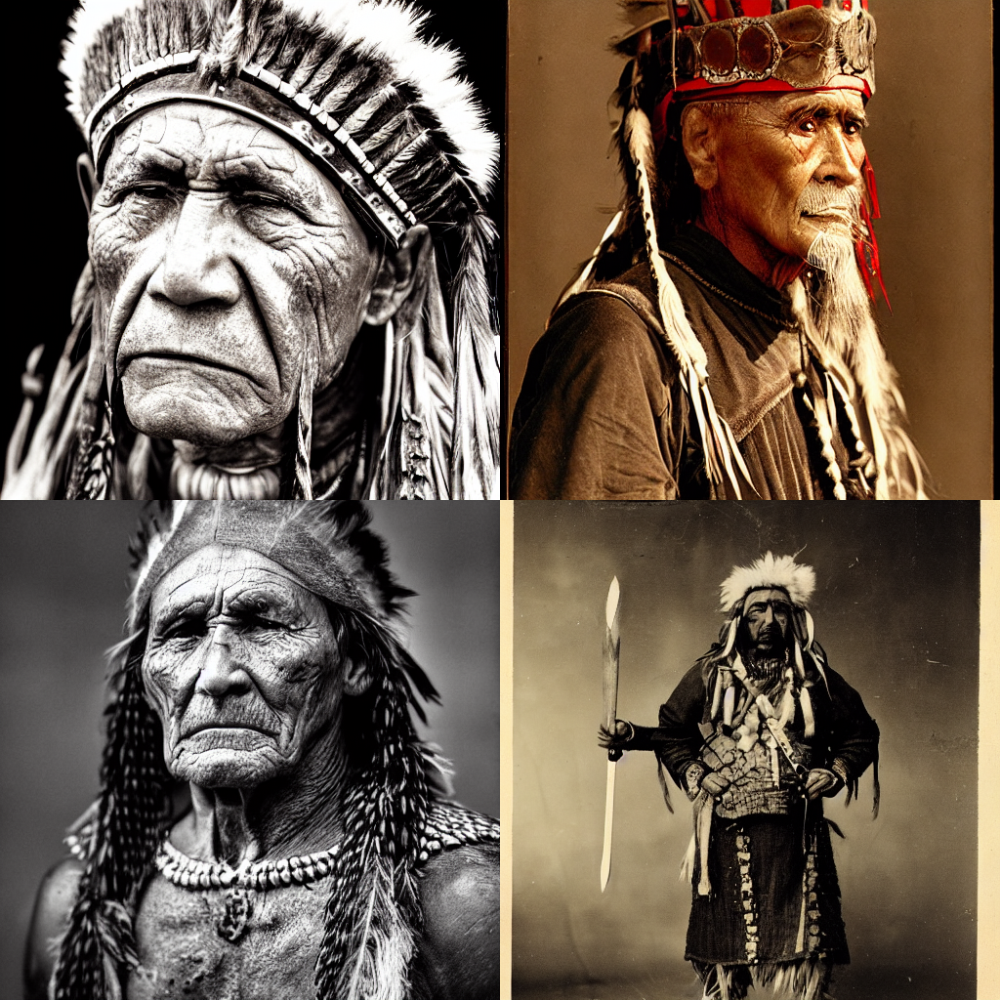

In [8]:
image_grid(output.images, 2, 2)

In [7]:
# Choosing a more efficient scheduler
# Stable Diffusion Uses PNDMScheduler by default which usually requires ~50 inference steps
# DPMSolverMultistepScheduler, require only ~20 or 25 inference steps.
from diffusers import DPMSolverMultistepScheduler, PNDMScheduler
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)

In [23]:
%%time
output_2 = pipe(**get_inputs(batch_size=4))

  0%|          | 0/50 [00:00<?, ?it/s]

CPU times: user 8.68 s, sys: 13.3 s, total: 22 s
Wall time: 21.8 s


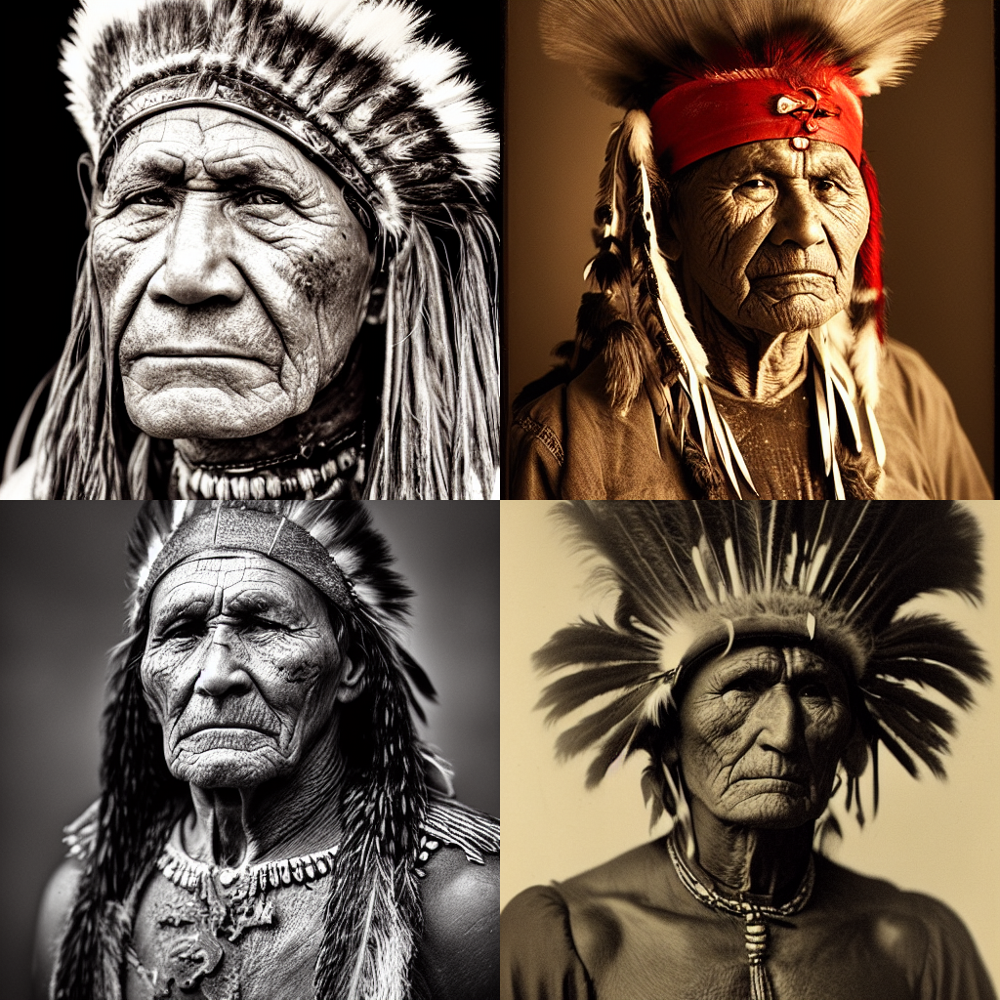

In [24]:
image_grid(output_2.images, rows=2, cols=2)

In [8]:
%%time
output_3 = pipe(**get_inputs(batch_size=4, prompt="Portrait of Lord Shri Ram"))

  0%|          | 0/50 [00:00<?, ?it/s]

CPU times: user 8.3 s, sys: 12.7 s, total: 21 s
Wall time: 20.9 s


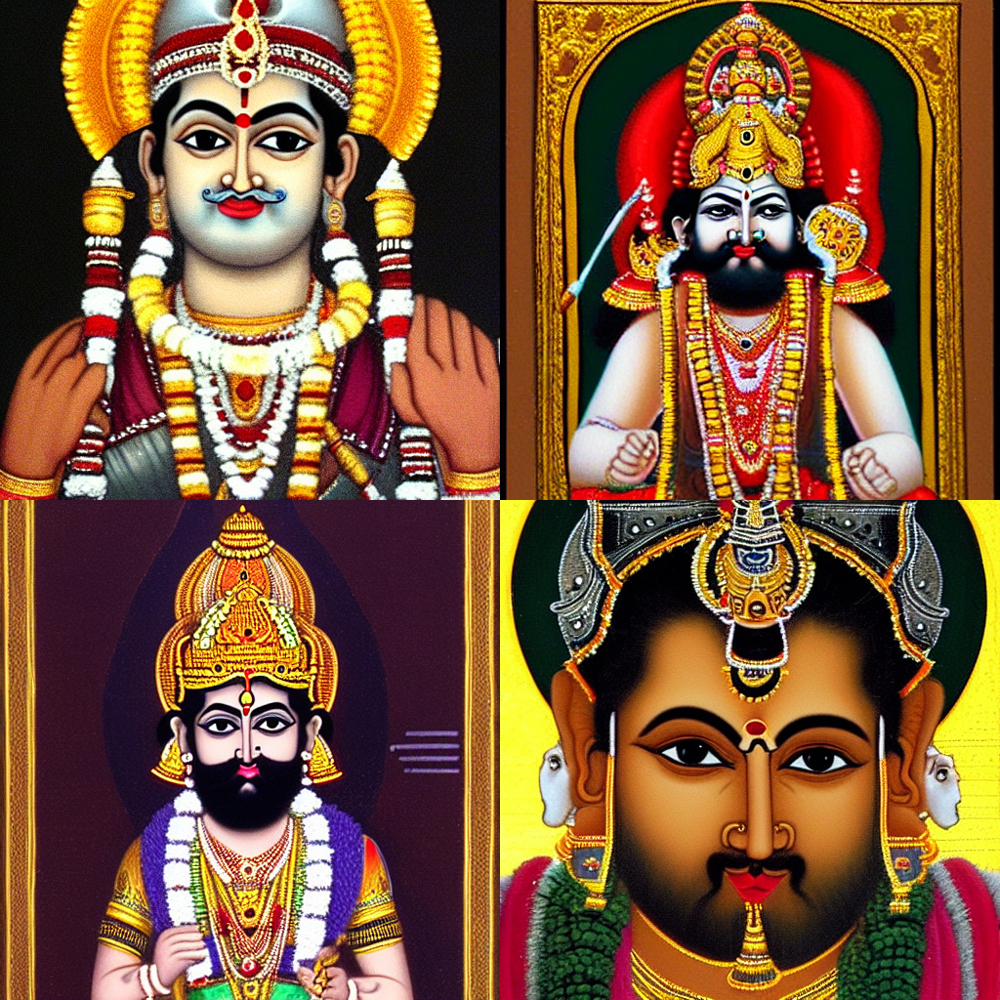

In [9]:
image_grid(output_3.images, 2, 2)

In [14]:
%%time
output_4 = pipe(**get_inputs(batch_size=4, prompt="portrait of lord shiva"))

  0%|          | 0/50 [00:00<?, ?it/s]

CPU times: user 8.38 s, sys: 14.7 s, total: 23.1 s
Wall time: 22.9 s


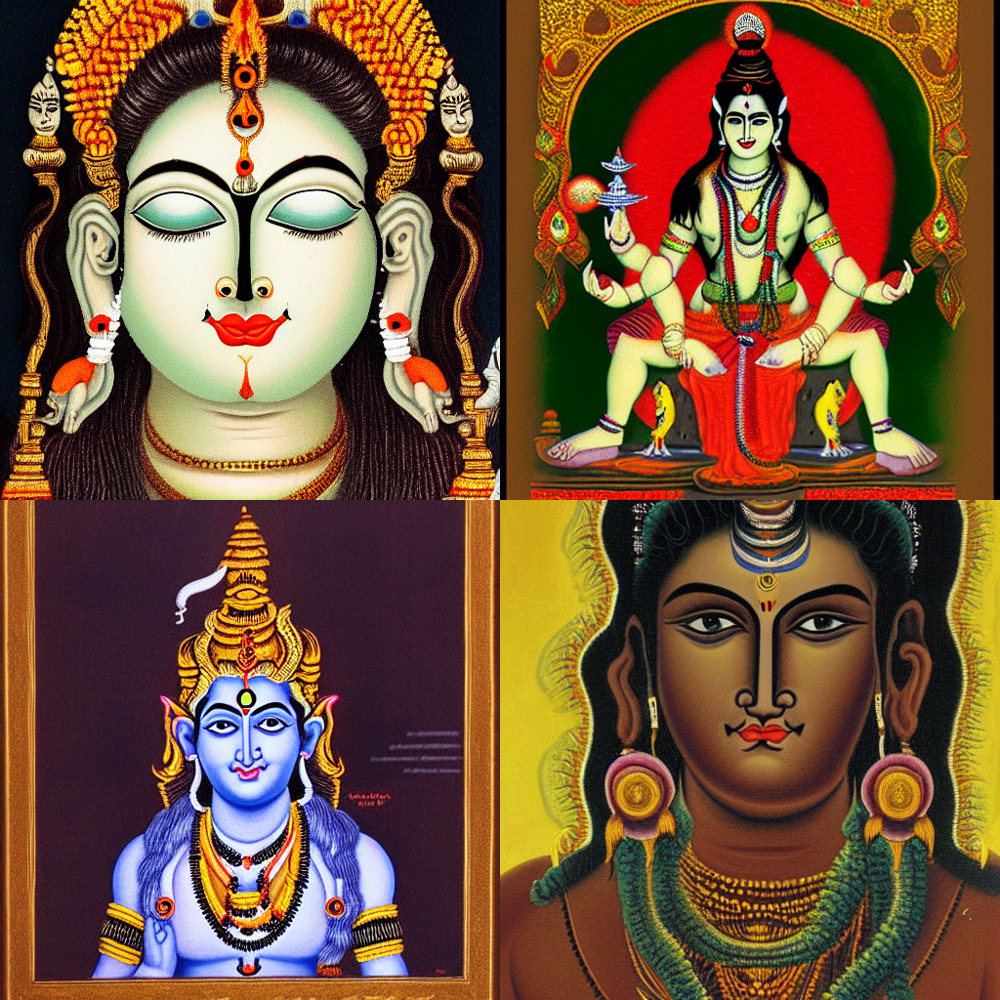

In [15]:
image_grid(output_4.images, 2, 2)

In [10]:
pipe.load_lora_weights("/home/aman/SelfStudy/Models/stable-diffusion/finetune/dreambooth/ram",
                       weight_name="pytorch_lora_weights.safetensors")

In [11]:
output_5 = pipe(**get_inputs(batch_size=4, prompt="Portrait of Lord Shri Ram"))

  0%|          | 0/50 [00:00<?, ?it/s]

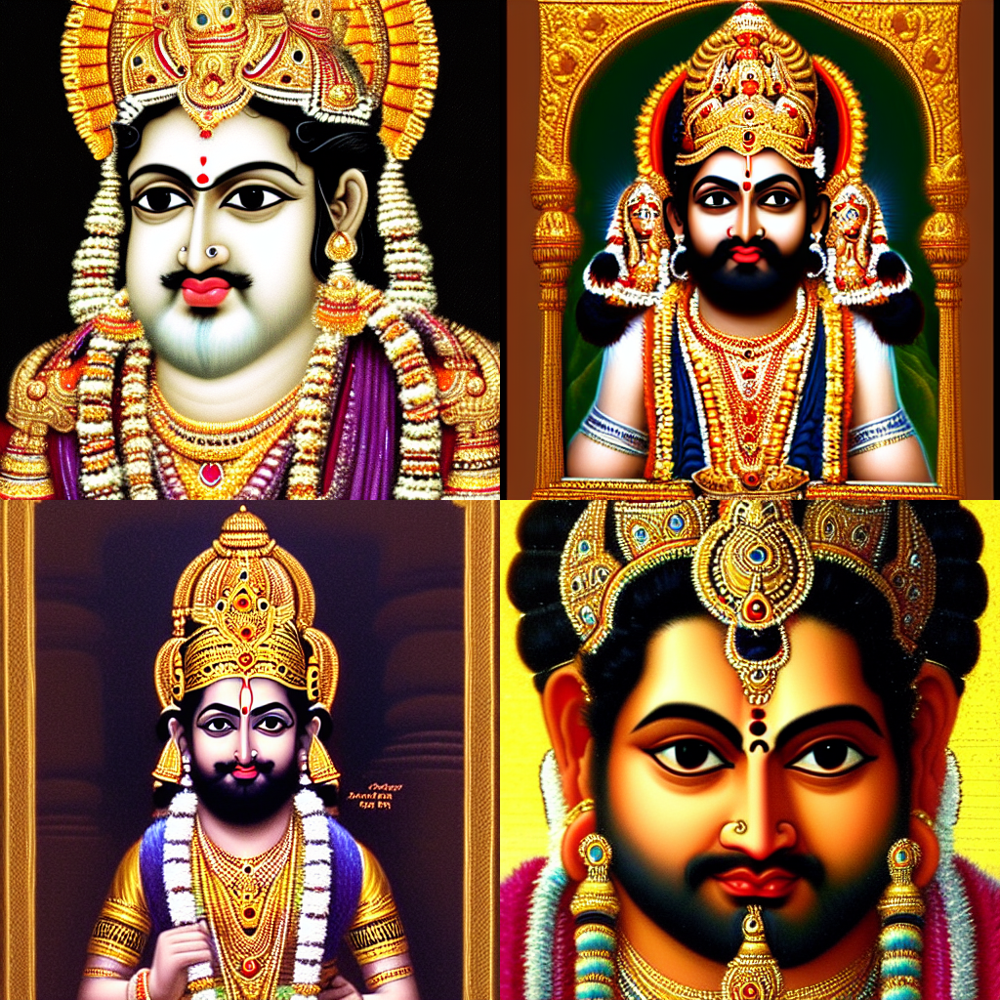

In [12]:
image_grid(output_5.images, 2, 2)

In [15]:
output_6 = pipe(**get_inputs(batch_size=4, prompt="Portrait of Lord Shiva"))

  0%|          | 0/50 [00:00<?, ?it/s]

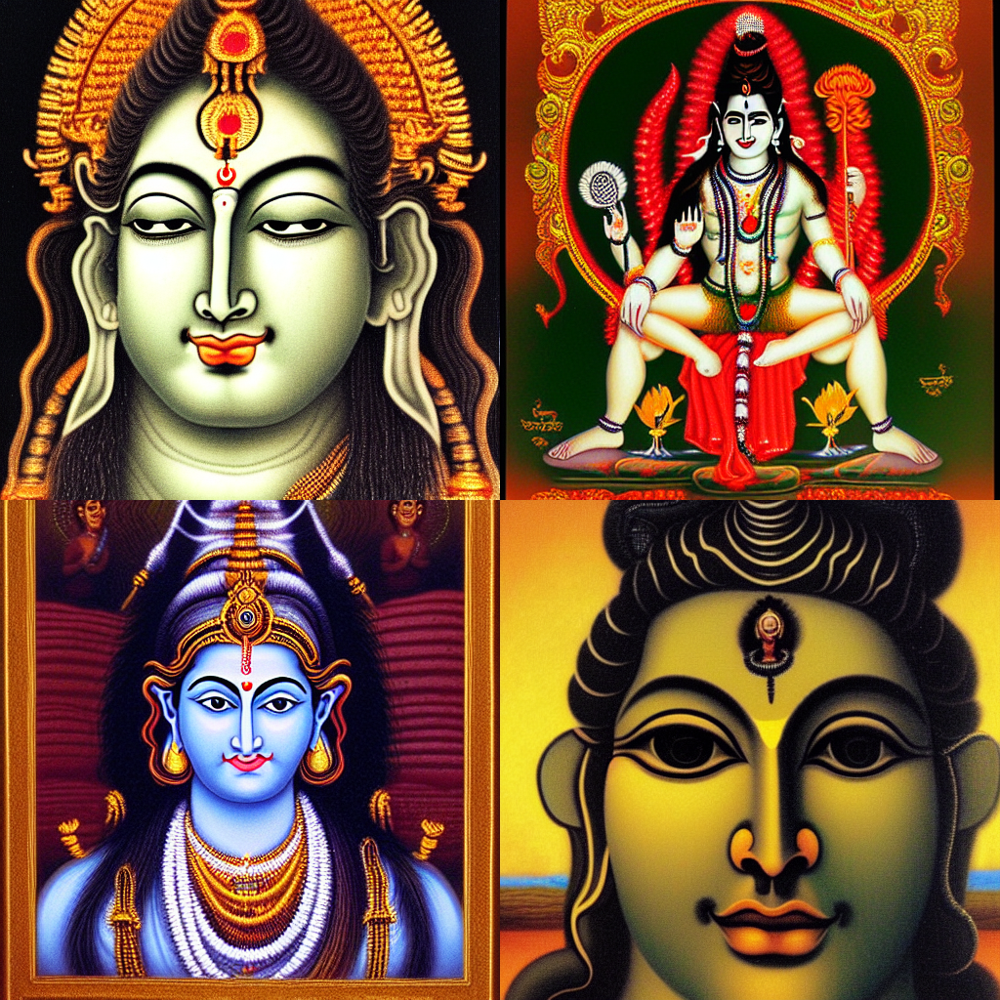

In [16]:
image_grid(output_6.images, 2, 2)

In [21]:
output_7 = pipe(**get_inputs(batch_size=4, prompt="Portrait of Lord Vishnu"))

  0%|          | 0/50 [00:00<?, ?it/s]

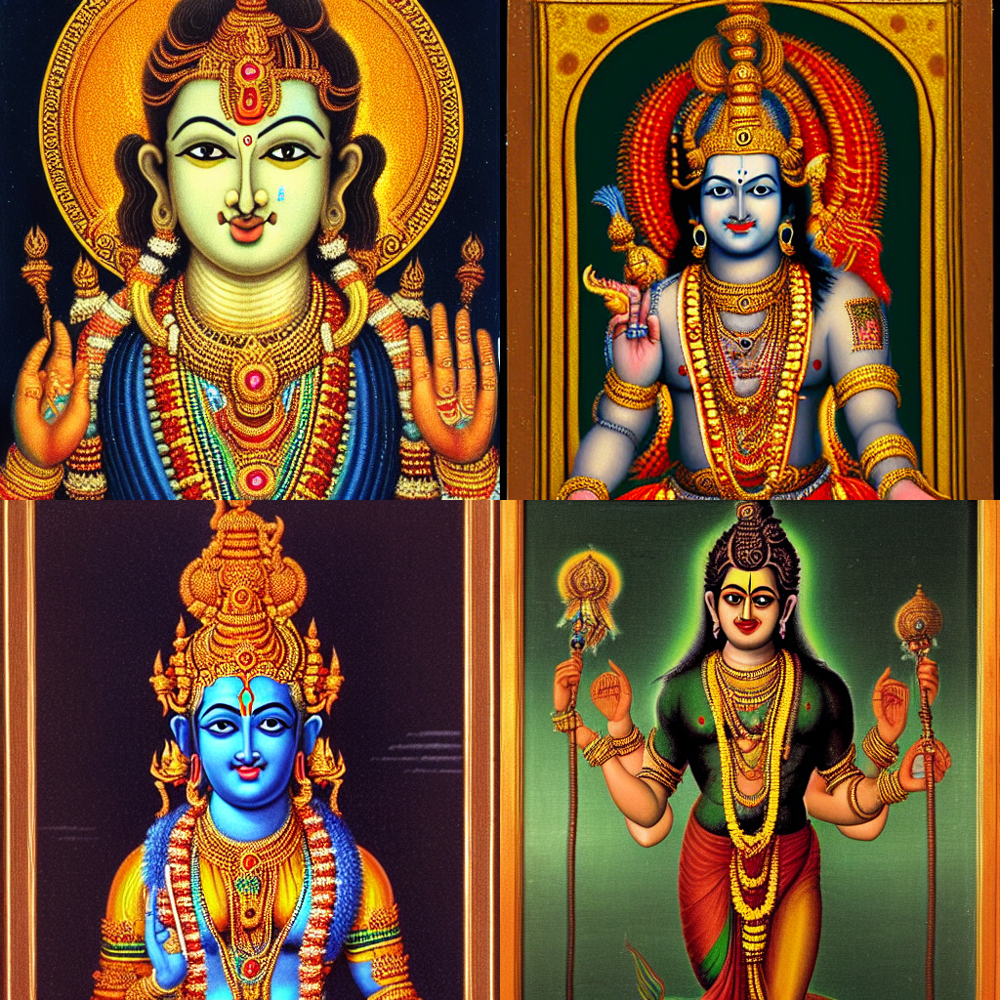

In [22]:
image_grid(output_7.images, 2, 2)